##### Copyright 2019 The TensorFlow Authors.

Licensed under the Apache License, Version 2.0 (the "License");

In [ ]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# pix2pix: Image-to-image translation with a conditional GAN

<table class="tfo-notebook-buttons" align="left">
  <td>
    <a target="_blank" href="https://www.tensorflow.org/tutorials/generative/pix2pix"><img src="https://www.tensorflow.org/images/tf_logo_32px.png" />View on TensorFlow.org</a>
  </td>
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/pix2pix.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/pix2pix.ipynb"><img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View source on GitHub</a>
  </td>
  <td>
    <a href="https://storage.googleapis.com/tensorflow_docs/docs/site/en/tutorials/generative/pix2pix.ipynb"><img src="https://www.tensorflow.org/images/download_logo_32px.png" />Download notebook</a>
  </td>
</table>

This tutorial demonstrates how to build and train a conditional generative adversarial network (cGAN) called pix2pix that learns a mapping from input images to output images, as described in [Image-to-image translation with conditional adversarial networks](https://arxiv.org/abs/1611.07004){:.external} by Isola et al. (2017). pix2pix is not application specific—it can be applied to a wide range of tasks, including synthesizing photos from label maps, generating colorized photos from black and white images, turning Google Maps photos into aerial images, and even transforming sketches into photos.

In this example, your network will generate images of building facades using the [CMP Facade Database](http://cmp.felk.cvut.cz/~tylecr1/facade/) provided by the [Center for Machine Perception](http://cmp.felk.cvut.cz/){:.external} at the [Czech Technical University in Prague](https://www.cvut.cz/){:.external}. To keep it short, you will use a [preprocessed copy](https://efrosgans.eecs.berkeley.edu/pix2pix/datasets/){:.external} of this dataset created by the pix2pix authors.

In the pix2pix cGAN, you condition on input images and generate corresponding output images. cGANs were first proposed in [Conditional Generative Adversarial Nets](https://arxiv.org/abs/1411.1784) (Mirza and Osindero, 2014)

The architecture of your network will contain:

- A generator with a [U-Net](https://arxiv.org/abs/1505.04597){:.external}-based architecture.
- A discriminator represented by a convolutional PatchGAN classifier (proposed in the [pix2pix paper](https://arxiv.org/abs/1611.07004){:.external}).

Note that each epoch can take around 15 seconds on a single V100 GPU.

Below are some examples of the output generated by the pix2pix cGAN after training for 200 epochs on the facades dataset (80k steps).

![sample output_1](https://www.tensorflow.org/images/gan/pix2pix_1.png)
![sample output_2](https://www.tensorflow.org/images/gan/pix2pix_2.png)

## Import TensorFlow and other libraries

In [ ]:
import tensorflow as tf

import os
import pathlib
import time
import datetime

from matplotlib import pyplot as plt
from IPython import display

## Load the dataset

Download the CMP Facade Database data (30MB). Additional datasets are available in the same format [here](http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/){:.external}. In Colab you can select other datasets from the drop-down menu. Note that some of the other datasets are significantly larger (`edges2handbags` is 8GB in size).

In [ ]:
!pip install gdown


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import gdown
import zipfile
import pathlib
import os
import tensorflow as tf

def list_all_files(startpath):
    for root, dirs, files in os.walk(startpath):
        for f in files:
            print(os.path.join(root, f))

def rename_images(folder_path):
    folder_path = pathlib.Path(folder_path)
    file_list = sorted(os.listdir(folder_path))

    counter = 1
    for file_name in file_list:
        file_extension = os.path.splitext(file_name)[1]
        new_file_name = f"{counter}{file_extension}"
        os.rename(folder_path / file_name, folder_path / new_file_name)
        counter += 1

dataset_name = "final"
_URL = 'https://drive.google.com/uc?export=download&id=1KDzI8w1JNVuNNXf3eU6wSUHhGCPLqLGA'

output = f"{dataset_name}.zip"
gdown.download(_URL, output, quiet=False)

path_to_zip = pathlib.Path(output)

with zipfile.ZipFile(path_to_zip, 'r') as zip_ref:
    zip_ref.extractall(path_to_zip.parent)

# 現在再次列出所有檔案
print("All files in the .keras/datasets directory:")
list_all_files(path_to_zip.parent)

PATH = path_to_zip.parent / "final"  # 請根據實際情況修改此行

print("Files in the directory:")
print(os.listdir(PATH / 'train'))

# 重新命名 train 和 val 資料夾中的圖片
train_folder_path = PATH / "train"
val_folder_path = PATH / "val"

rename_images(train_folder_path)
rename_images(val_folder_path)

# 再次列出重新命名後的檔案
print("Files in the train directory after renaming:")
print(os.listdir(train_folder_path))
print("Files in the val directory after renaming:")
print(os.listdir(val_folder_path))

# 以下是您提供的內容，我已經將它們加入到合併後的代碼中

sample_image = tf.io.read_file(str(train_folder_path / '1.jpg'))
sample_image = tf.io.decode_jpeg(sample_image)
print(sample_image.shape)


Downloading...
From: https://drive.google.com/uc?export=download&id=1KDzI8w1JNVuNNXf3eU6wSUHhGCPLqLGA
To: /content/final.zip
100%|██████████| 66.2M/66.2M [00:01<00:00, 54.7MB/s]


All files in the .keras/datasets directory:
./final.zip
./.config/active_config
./.config/.last_survey_prompt.yaml
./.config/.last_opt_in_prompt.yaml
./.config/config_sentinel
./.config/gce
./.config/.last_update_check.json
./.config/logs/2023.06.14/18.25.27.863651.log
./.config/logs/2023.06.14/18.26.26.834402.log
./.config/logs/2023.06.14/18.25.59.112911.log
./.config/logs/2023.06.14/18.26.36.418006.log
./.config/logs/2023.06.14/18.27.06.013106.log
./.config/logs/2023.06.14/18.27.05.120698.log
./.config/configurations/config_default
./final/train/ (93).jpg
./final/train/ (243).jpg
./final/train/ (433).jpg
./final/train/ (266).jpg
./final/train/ (62).jpg
./final/train/ (330).jpg
./final/train/ (387).jpg
./final/train/ (324).jpg
./final/train/ (80).jpg
./final/train/ (219).jpg
./final/train/ (143).jpg
./final/train/ (119).jpg
./final/train/ (432).jpg
./final/train/ (159).jpg
./final/train/ (204).jpg
./final/train/ (70).jpg
./final/train/ (270).jpg
./final/train/ (155).jpg
./final/train/

In [ ]:
list(PATH.parent.iterdir())

[PosixPath('.config'),
 PosixPath('final.zip'),
 PosixPath('final'),
 PosixPath('sample_data')]

Each original image is of size `256 x 512` containing two `256 x 256` images:

In [ ]:
sample_image = tf.io.read_file(str(PATH / 'train/1.jpg'))
sample_image = tf.io.decode_jpeg(sample_image)
print(sample_image.shape)

(256, 512, 3)


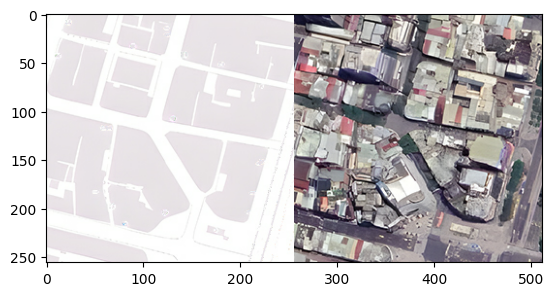

In [ ]:
plt.figure()
plt.imshow(sample_image)

You need to separate real building facade images from the architecture label images—all of which will be of size `256 x 256`.

Define a function that loads image files and outputs two image tensors:

In [ ]:
def load(image_file):
    # Read and decode an image file to a uint8 tensor
    image = tf.io.read_file(image_file)
    image = tf.io.decode_jpeg(image)

    # Split each image tensor into two tensors:
    # - one with a real building facade image
    # - one with an architecture label image
    w = tf.shape(image)[1]
    w = w // 2
    real_image = image[:, w:, :]  # 已交換位置
    input_image = image[:, :w, :]  # 已交換位置

    # Convert both images to float32 tensors
    input_image = tf.cast(input_image, tf.float32)
    real_image = tf.cast(real_image, tf.float32)

    return input_image, real_image


Plot a sample of the input (architecture label image) and real (building facade photo) images:

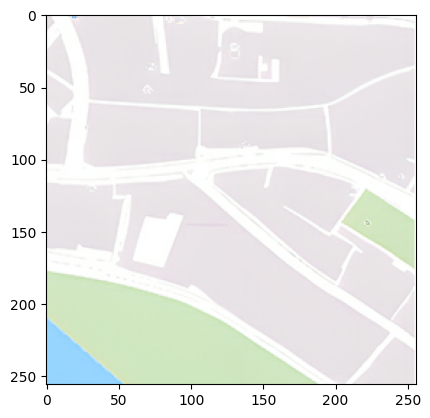

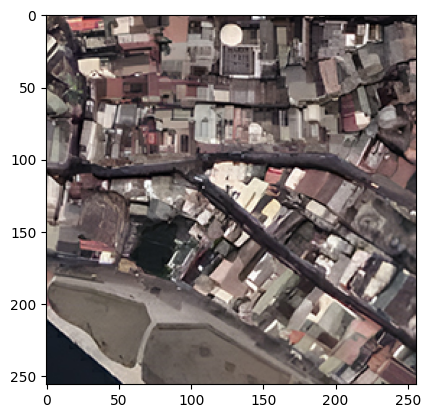

In [ ]:
inp, re = load(str(PATH / 'train/50.jpg'))
# Casting to int for matplotlib to display the images
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

As described in the [pix2pix paper](https://arxiv.org/abs/1611.07004){:.external}, you need to apply random jittering and mirroring to preprocess the training set.

Define several functions that:

1. Resize each `256 x 256` image to a larger height and width—`286 x 286`.
2. Randomly crop it back to `256 x 256`.
3. Randomly flip the image horizontally i.e. left to right (random mirroring).
4. Normalize the images to the `[-1, 1]` range.

In [ ]:
# The facade training set consist of 400 images
BUFFER_SIZE = 400
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [ ]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [ ]:
#def random_crop(input_image, real_image):
  #stacked_image = tf.stack([input_image, real_image], axis=0)
  #cropped_image = tf.image.random_crop(
     # stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  #return cropped_image[0], cropped_image[1]

In [ ]:
import tensorflow as tf

def random_crop(input_image, real_image):
    stacked_image = tf.stack([input_image, real_image], axis=0)
    cropped_image = tf.image.random_crop(stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

    # 隨機水平翻轉
    if tf.random.uniform(()) > 0.4:
        cropped_image = tf.image.flip_left_right(cropped_image)

    # 隨機垂直翻轉
    if tf.random.uniform(()) > 0.4:
        cropped_image = tf.image.flip_up_down(cropped_image)

    # 隨機旋轉，限制在90度的倍數
    k = tf.random.uniform(shape=[], minval=0, maxval=6, dtype=tf.int32)
    cropped_image = tf.image.rot90(cropped_image, k=k)

    # 再次裁剪以確保維持原始尺寸
    cropped_image = tf.image.resize_with_crop_or_pad(cropped_image, IMG_HEIGHT, IMG_WIDTH)

    return cropped_image[0], cropped_image[1]



In [ ]:
# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

In [ ]:
@tf.function()
def random_jitter(input_image, real_image):
  # Resizing to 286x286
  input_image, real_image = resize(input_image, real_image, 286, 286)

  # Random cropping back to 256x256
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.4:
    # Random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

You can inspect some of the preprocessed output:

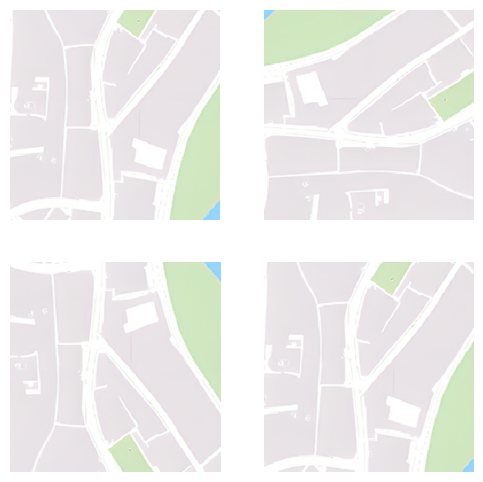

In [ ]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re)
  plt.subplot(2, 2, i + 1)
  plt.imshow(rj_inp / 255.0)
  plt.axis('off')
plt.show()

Having checked that the loading and preprocessing works, let's define a couple of helper functions that load and preprocess the training and test sets:

In [ ]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [ ]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

## Build an input pipeline with `tf.data`

In [ ]:
def check_missing_files(folder_path, expected_file_count):
    folder_path = pathlib.Path(folder_path)
    file_list = sorted(os.listdir(folder_path))
    current_file_count = len(file_list)

    if current_file_count == expected_file_count:
        print(f"{folder_path} has no missing files. Total files: {current_file_count}")
    else:
        missing_files = expected_file_count - current_file_count
        print(f"{folder_path} has {missing_files} missing files. Total files: {current_file_count}")


In [ ]:
# 使用預期的文件數量檢查 train 和 val 資料夾中的缺失文件
expected_train_file_count = 621  # 根據實際情況修改此數字
expected_val_file_count = 121  # 根據實際情況修改此數字

check_missing_files(train_folder_path, expected_train_file_count)
check_missing_files(val_folder_path, expected_val_file_count)


final/train has 168 missing files. Total files: 453
final/val has 27 missing files. Total files: 94


In [ ]:
!ls -R final


final:
train  val

final/train:
100.jpg  147.jpg  193.jpg  239.jpg  285.jpg  330.jpg  377.jpg  422.jpg	5.jpg
101.jpg  148.jpg  194.jpg  23.jpg   286.jpg  331.jpg  378.jpg  423.jpg	60.jpg
102.jpg  149.jpg  195.jpg  240.jpg  287.jpg  332.jpg  379.jpg  424.jpg	61.jpg
103.jpg  14.jpg   196.jpg  241.jpg  288.jpg  333.jpg  37.jpg   425.jpg	62.jpg
104.jpg  150.jpg  197.jpg  242.jpg  289.jpg  334.jpg  380.jpg  426.jpg	63.jpg
105.jpg  151.jpg  198.jpg  243.jpg  28.jpg   335.jpg  381.jpg  427.jpg	64.jpg
106.jpg  152.jpg  199.jpg  244.jpg  290.jpg  336.jpg  382.jpg  428.jpg	65.jpg
107.jpg  153.jpg  19.jpg   245.jpg  291.jpg  337.jpg  383.jpg  429.jpg	66.jpg
108.jpg  154.jpg  1.jpg    246.jpg  292.jpg  338.jpg  384.jpg  42.jpg	67.jpg
109.jpg  155.jpg  200.jpg  247.jpg  293.jpg  339.jpg  385.jpg  430.jpg	68.jpg
10.jpg	 156.jpg  201.jpg  248.jpg  294.jpg  33.jpg   386.jpg  431.jpg	69.jpg
110.jpg  157.jpg  202.jpg  249.jpg  295.jpg  340.jpg  387.jpg  432.jpg	6.jpg
111.jpg  158.jpg  203.jpg  24.jpg   

In [ ]:
train_dataset = tf.data.Dataset.list_files(str(PATH / 'train/*.jpg'))
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [ ]:
try:
  test_dataset = tf.data.Dataset.list_files(str(PATH / 'test/*.jpg'))
except tf.errors.InvalidArgumentError:
  test_dataset = tf.data.Dataset.list_files(str(PATH / 'val/*.jpg'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

## Build the generator

The generator of your pix2pix cGAN is a _modified_ [U-Net](https://arxiv.org/abs/1505.04597){:.external}. A U-Net consists of an encoder (downsampler) and decoder (upsampler). (You can find out more about it in the [Image segmentation](../images/segmentation.ipynb) tutorial and on the [U-Net project website](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/){:.external}.)

- Each block in the encoder is: Convolution -> Batch normalization -> Leaky ReLU
- Each block in the decoder is: Transposed convolution -> Batch normalization -> Dropout (applied to the first 3 blocks) -> ReLU
- There are skip connections between the encoder and decoder (as in the U-Net).

Define the downsampler (encoder):

In [ ]:
OUTPUT_CHANNELS = 3

In [ ]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [ ]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

(1, 128, 128, 3)


Define the upsampler (decoder):

In [ ]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [ ]:
up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

(1, 256, 256, 3)


Define the generator with the downsampler and the upsampler:

In [ ]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)
    downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

Visualize the generator model architecture:

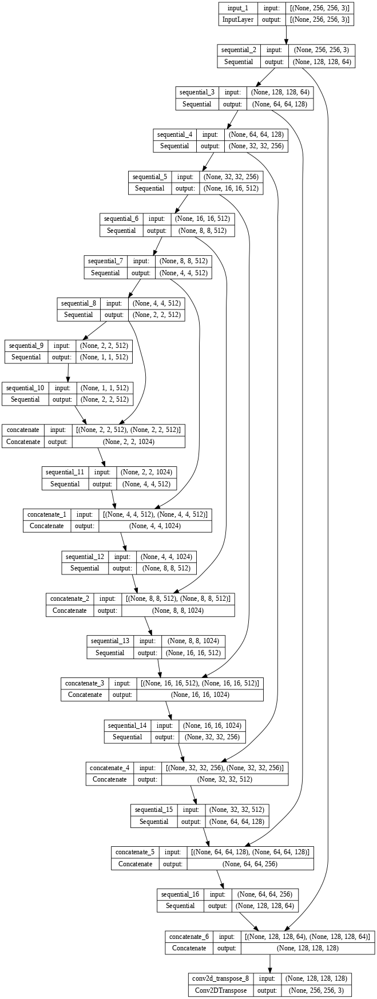

In [ ]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

Test the generator:

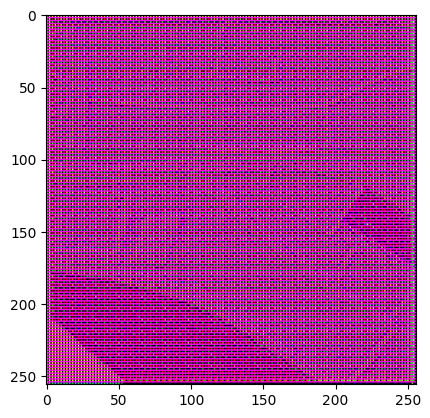

In [ ]:
gen_output = generator(inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

### Define the generator loss

GANs learn a loss that adapts to the data, while cGANs learn a structured loss that penalizes a possible structure that differs from the network output and the target image, as described in the [pix2pix paper](https://arxiv.org/abs/1611.07004){:.external}.

- The generator loss is a sigmoid cross-entropy loss of the generated images and an **array of ones**.
- The pix2pix paper also mentions the L1 loss, which is a MAE (mean absolute error) between the generated image and the target image.
- This allows the generated image to become structurally similar to the target image.
- The formula to calculate the total generator loss is `gan_loss + LAMBDA * l1_loss`, where `LAMBDA = 100`. This value was decided by the authors of the paper.

In [ ]:
LAMBDA = 100

In [ ]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

The training procedure for the generator is as follows:

![Generator Update Image](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/gen.png?raw=1)


## Build the discriminator

The discriminator in the pix2pix cGAN is a convolutional PatchGAN classifier—it tries to classify if each image _patch_ is real or not real, as described in the [pix2pix paper](https://arxiv.org/abs/1611.07004){:.external}.

- Each block in the discriminator is: Convolution -> Batch normalization -> Leaky ReLU.
- The shape of the output after the last layer is `(batch_size, 30, 30, 1)`.
- Each `30 x 30` image patch of the output classifies a `70 x 70` portion of the input image.
- The discriminator receives 2 inputs:
    - The input image and the target image, which it should classify as real.
    - The input image and the generated image (the output of the generator), which it should classify as fake.
    - Use `tf.concat([inp, tar], axis=-1)` to concatenate these 2 inputs together.

Let's define the discriminator:

In [ ]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

Visualize the discriminator model architecture:

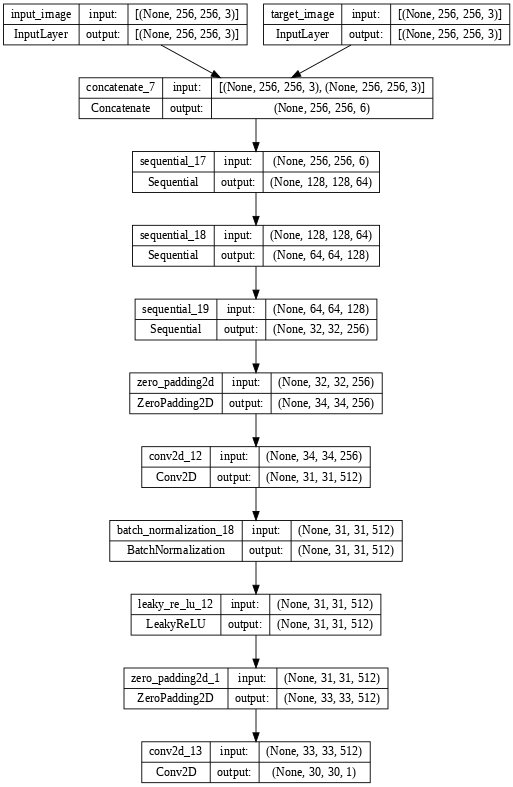

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

Test the discriminator:

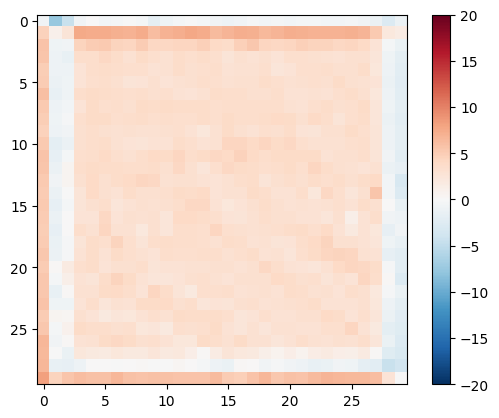

In [ ]:
disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

### Define the discriminator loss

- The `discriminator_loss` function takes 2 inputs: **real images** and **generated images**.
- `real_loss` is a sigmoid cross-entropy loss of the **real images** and an **array of ones(since these are the real images)**.
- `generated_loss` is a sigmoid cross-entropy loss of the **generated images** and an **array of zeros (since these are the fake images)**.
- The `total_loss` is the sum of `real_loss` and `generated_loss`.

In [ ]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

The training procedure for the discriminator is shown below.

To learn more about the architecture and the hyperparameters you can refer to the [pix2pix paper](https://arxiv.org/abs/1611.07004){:.external}.

![Discriminator Update Image](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/dis.png?raw=1)


## Define the optimizers and a checkpoint-saver


In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Generate images

Write a function to plot some images during training.

- Pass images from the test set to the generator.
- The generator will then translate the input image into the output.
- The last step is to plot the predictions and _voila_!

Note: The `training=True` is intentional here since you want the batch statistics, while running the model on the test dataset. If you use `training=False`, you get the accumulated statistics learned from the training dataset (which you don't want).

In [ ]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

Test the function:

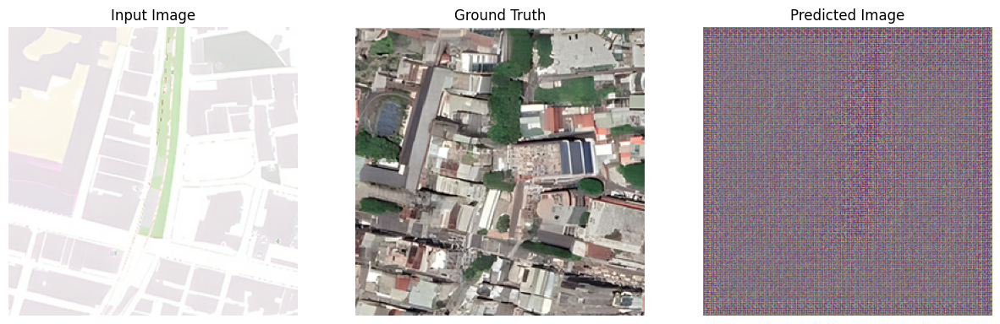

In [ ]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

## Training

- For each example input generates an output.
- The discriminator receives the `input_image` and the generated image as the first input. The second input is the `input_image` and the `target_image`.
- Next, calculate the generator and the discriminator loss.
- Then, calculate the gradients of loss with respect to both the generator and the discriminator variables(inputs) and apply those to the optimizer.
- Finally, log the losses to TensorBoard.

In [ ]:
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
@tf.function
def train_step(input_image, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

The actual training loop. Since this tutorial can run of more than one dataset, and the datasets vary greatly in size the training loop is setup to work in steps instead of epochs.

- Iterates over the number of steps.
- Every 10 steps print a dot (`.`).
- Every 1k steps: clear the display and run `generate_images` to show the progress.
- Every 5k steps: save a checkpoint.

In [ ]:
import os

# 確保輸出目錄存在
output_dir = 'output_images'
os.makedirs(output_dir, exist_ok=True)

def generate_images(model, test_input, tar, step):
    # 模型在此處用於預測輸出
    prediction = model(test_input, training=True)

    # 調整圖像大小
    plt.figure(figsize=(10,3))

    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # 獲取 [0, 1] 之間的像素值以進行繪圖
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')

    # 調整子圖之間的間距
    plt.subplots_adjust(wspace=0.02, hspace=0.02)
    plt.savefig(os.path.join(output_dir, f'step_{step//1000}.png'), bbox_inches='tight', pad_inches=0)  # 將圖形保存為文件
    plt.show()  # 顯示圖形

def fit(train_ds, test_ds, steps):
  example_input, example_target = next(iter(test_ds.take(1)))
  start = time.time()

  for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
    if (step) % 1000 == 0:
      display.clear_output(wait=True)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

      start = time.time()

      generate_images(generator, example_input, example_target, step)  # 將 'step' 傳入 generate_images
      print(f"Step: {step//1000}k")

    train_step(input_image, target, step)

    # 訓練步驟
    if (step+1) % 10 == 0:
      print('.', end='', flush=True)

    # 每 5k 步驟保存（檢查點）模型
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)


This training loop saves logs that you can view in TensorBoard to monitor the training progress.

If you work on a local machine, you would launch a separate TensorBoard process. When working in a notebook, launch the viewer before starting the training to monitor with TensorBoard.

Launch the TensorBoard viewer (Sorry, this doesn't
display on tensorflow.org):

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

You can view the [results of a previous run](https://tensorboard.dev/experiment/lZ0C6FONROaUMfjYkVyJqw) of this notebook on [TensorBoard.dev](https://tensorboard.dev/).

Finally, run the training loop:

Time taken for 1000 steps: 91.37 sec



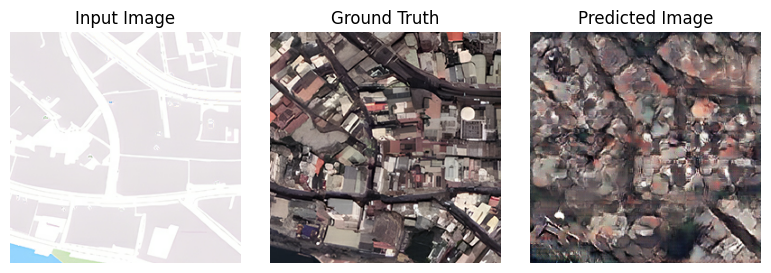

Step: 16k
..................

In [ ]:
fit(train_dataset, test_dataset, steps=50000)

Interpreting the logs is more subtle when training a GAN (or a cGAN like pix2pix) compared to a simple classification or regression model. Things to look for:

- Check that neither the generator nor the discriminator model has "won". If either the `gen_gan_loss` or the `disc_loss` gets very low, it's an indicator that this model is dominating the other, and you are not successfully training the combined model.
- The value `log(2) = 0.69` is a good reference point for these losses, as it indicates a perplexity of 2 - the discriminator is, on average, equally uncertain about the two options.
- For the `disc_loss`, a value below `0.69` means the discriminator is doing better than random on the combined set of real and generated images.
- For the `gen_gan_loss`, a value below `0.69` means the generator is doing better than random at fooling the discriminator.
- As training progresses, the `gen_l1_loss` should go down.

## Restore the latest checkpoint and test the network

In [ ]:
!ls {checkpoint_dir}

checkpoint		     ckpt-5.data-00000-of-00001
ckpt-10.data-00000-of-00001  ckpt-5.index
ckpt-10.index		     ckpt-6.data-00000-of-00001
ckpt-1.data-00000-of-00001   ckpt-6.index
ckpt-1.index		     ckpt-7.data-00000-of-00001
ckpt-2.data-00000-of-00001   ckpt-7.index
ckpt-2.index		     ckpt-8.data-00000-of-00001
ckpt-3.data-00000-of-00001   ckpt-8.index
ckpt-3.index		     ckpt-9.data-00000-of-00001
ckpt-4.data-00000-of-00001   ckpt-9.index
ckpt-4.index


In [ ]:
# Restoring the latest checkpoint in checkpoint_dir
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [ ]:
!zip -r output_images.zip output_images/


  adding: output_images/ (stored 0%)
  adding: output_images/step_38.png (deflated 0%)
  adding: output_images/step_15.png (deflated 0%)
  adding: output_images/step_18.png (deflated 0%)
  adding: output_images/step_22.png (deflated 0%)
  adding: output_images/step_45.png (deflated 0%)
  adding: output_images/step_12.png (deflated 0%)
  adding: output_images/step_29.png (deflated 0%)
  adding: output_images/step_37.png (deflated 0%)
  adding: output_images/step_49.png (deflated 0%)
  adding: output_images/step_14.png (deflated 0%)
  adding: output_images/step_42.png (deflated 0%)
  adding: output_images/step_35.png (deflated 0%)
  adding: output_images/step_26.png (deflated 0%)
  adding: output_images/step_7.png (deflated 0%)
  adding: output_images/step_20.png (deflated 0%)
  adding: output_images/step_9.png (deflated 0%)
  adding: output_images/step_32.png (deflated 0%)
  adding: output_images/step_6.png (deflated 0%)
  adding: output_images/step_24.png (deflated 0%)
  adding: output

In [ ]:
from google.colab import files

# 下載文件
files.download('output_images.zip')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Generate some images using the test set

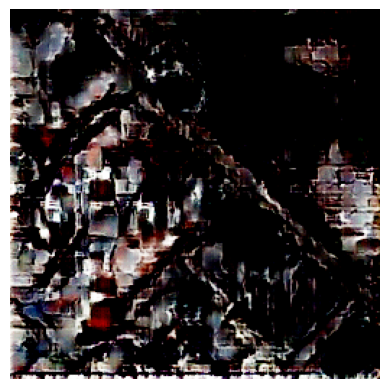

In [ ]:
import urllib.request
import cv2

# Download the image from the URL
url = "https://drive.google.com/uc?export=download&id=1T6wLl9_v0zKn5osVrtum5s9iUjuO5A-e"
urllib.request.urlretrieve(url, "test_image.jpg")

# Read the image, resize and normalize it
new_image = cv2.imread("test_image.jpg")
new_image = cv2.resize(new_image, (256, 256))
new_image = new_image / 127.5 - 1.0

# Convert the image to a tensor and generate the output
new_image = tf.convert_to_tensor(new_image, dtype=tf.float32)
generated_image = generator(new_image[tf.newaxis,...], training=True)

# Display the output image
plt.imshow(generated_image[0,...], vmin=0, vmax=255)
plt.axis('off')
plt.show()


In [ ]:
!pip install requests


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


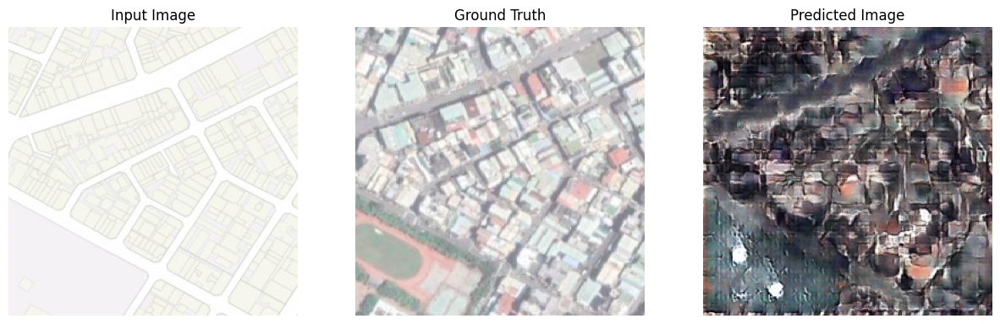

In [ ]:
import numpy as np
import tensorflow as tf
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt

def load_image_from_url(image_url):
    response = requests.get(image_url)
    return Image.open(BytesIO(response.content))

def display_input_generated_target(input_image, generated_image, target_image):
    plt.figure(figsize=(15, 15))

    display_list = [input_image[0], target_image[0], generated_image[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.show()

# Load the 256x512 image from the URL
image_url = 'https://drive.google.com/uc?export=download&id=1KNYVKVjMb8ZIaMJsV8h5q8s4V7nGPvg4'
image = load_image_from_url(image_url)

# Crop the ground truth image from the left half
ground_truth_image = image.crop((0, 0, 256, 256))

# Crop the input image from the right half
input_image = image.crop((256, 0, 512, 256))

# Convert the input image and ground truth image to numpy arrays and normalize the pixel values
input_image = np.array(input_image) / 255.0
ground_truth_image = np.array(ground_truth_image) / 255.0

# Add an extra dimension for the batch size
input_image = input_image[tf.newaxis, ...]
ground_truth_image = ground_truth_image[tf.newaxis, ...]

# Generate the output using the generator model
generated_image = generator(input_image, training=True)

# Display the input, generated, and target images
display_input_generated_target(input_image, generated_image, ground_truth_image)


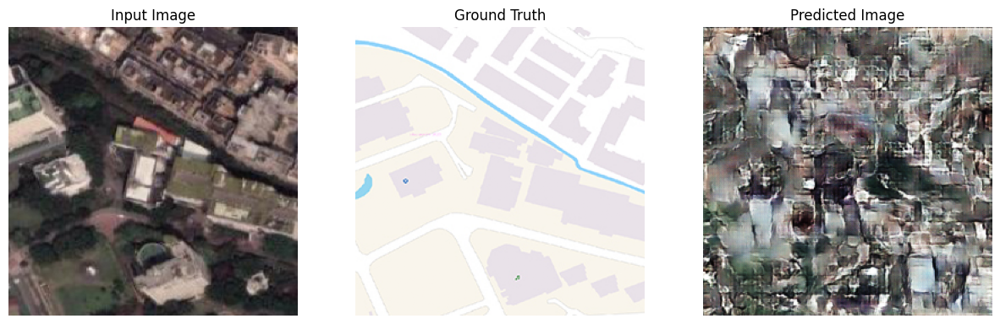

In [ ]:
def display_input_generated_target(input_image, generated_image, target_image):
    plt.figure(figsize=(15, 15))

    input_image = (input_image[0] * 0.5) + 0.5
    generated_image = (generated_image[0] * 0.5) + 0.5
    target_image = (target_image[0] * 0.5) + 0.5

    display_list = [input_image, target_image, generated_image]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')
    plt.show()

# Assuming you have a trained generator (pix2pix model) called 'generator'
# Replace 'your_target_image_url' with the actual URL of the target image
target_image_url = 'https://drive.google.com/uc?export=download&id=149RejYqPHb0DCH4p23nRuC8oFyqkEwNu'
target_image = load_image_from_url(target_image_url)
target_image = target_image.resize((512, 256))
target_image = np.array(target_image) / 255.0
target_image = target_image * 2 - 1
target_image = np.expand_dims(target_image, axis=0)
target_image = tf.convert_to_tensor(target_image, dtype=tf.float32)

input_image = target_image[:, :, 256:]
ground_truth = target_image[:, :, :256]

# Generate the output using the generator model
generated_image = generator(input_image, training=True)

# Display the input, generated, and target images
display_input_generated_target(input_image, generated_image, ground_truth)


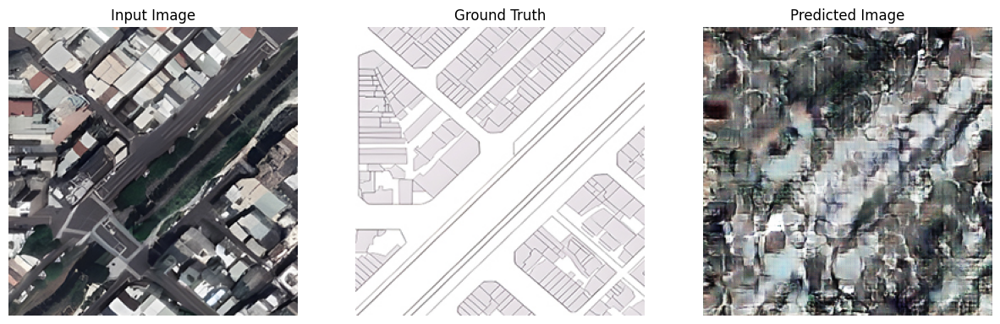

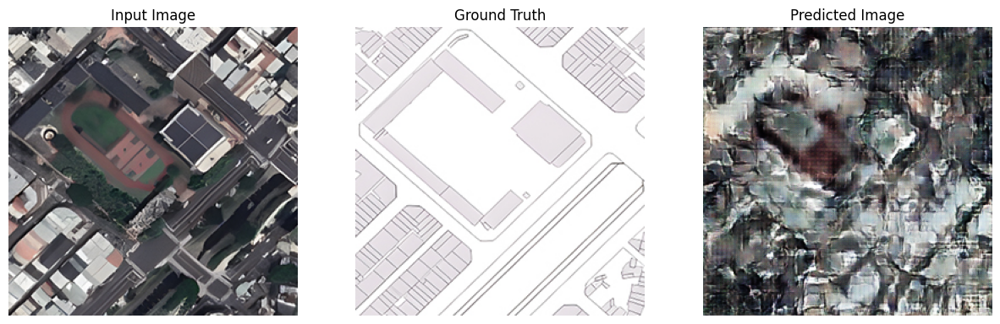

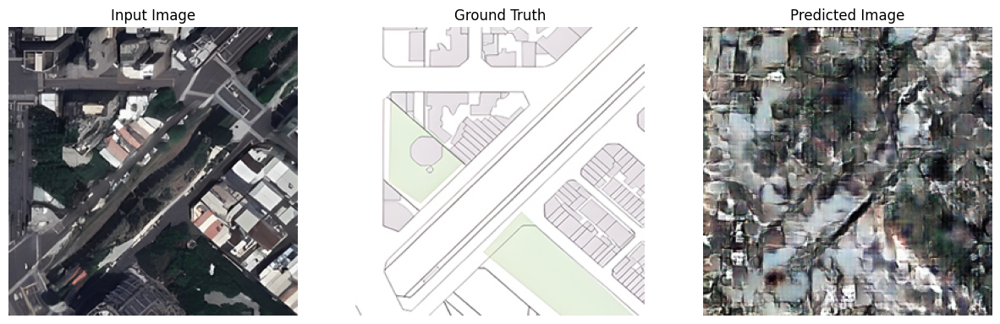

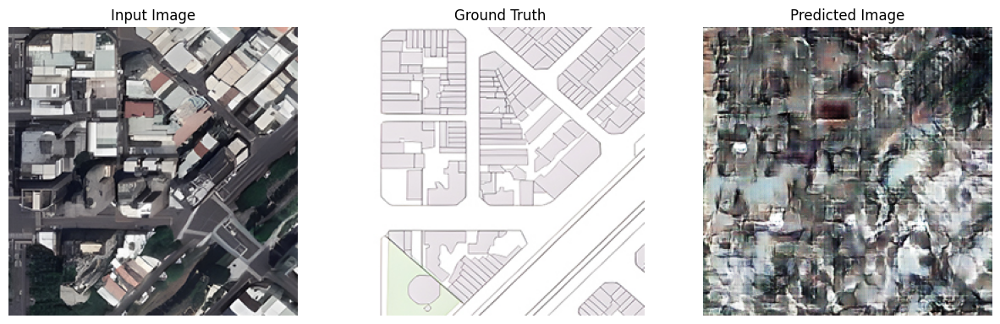

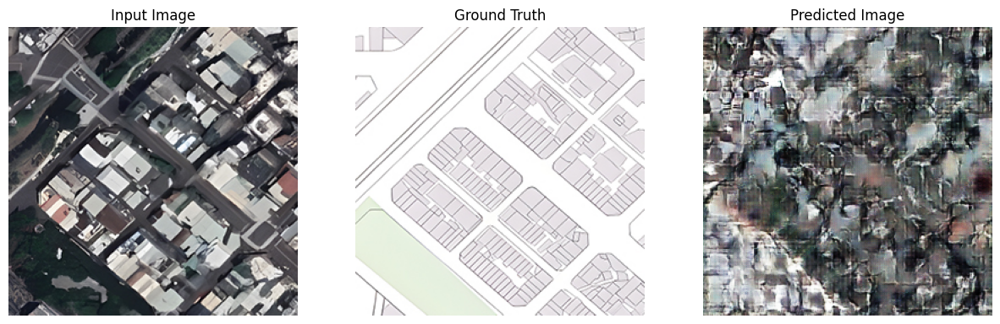

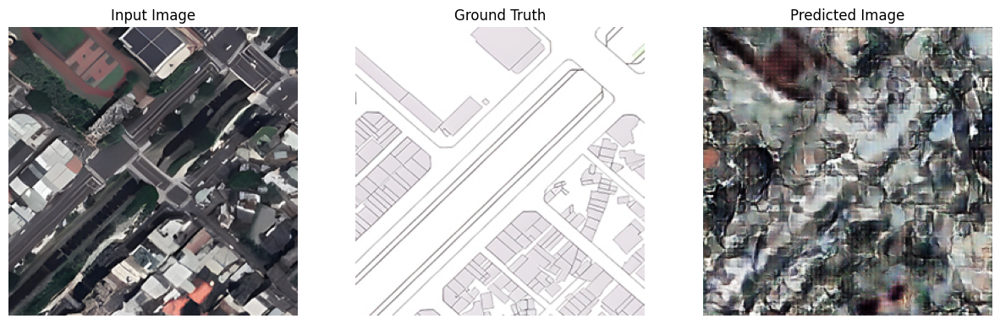

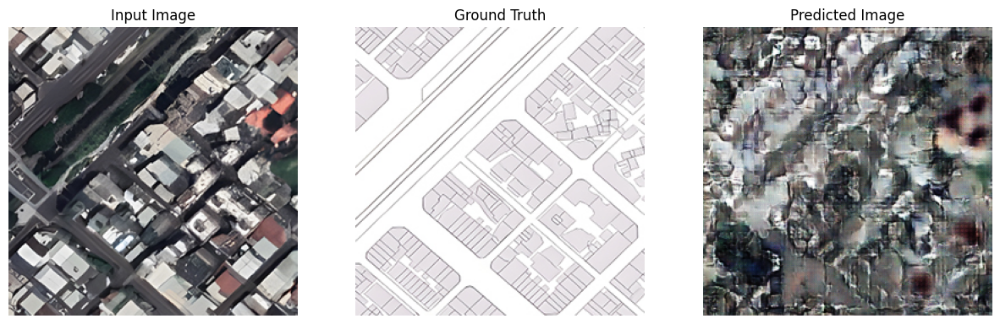

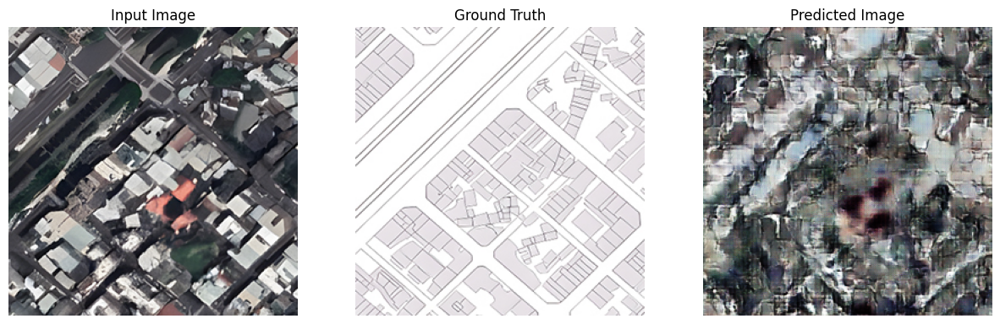

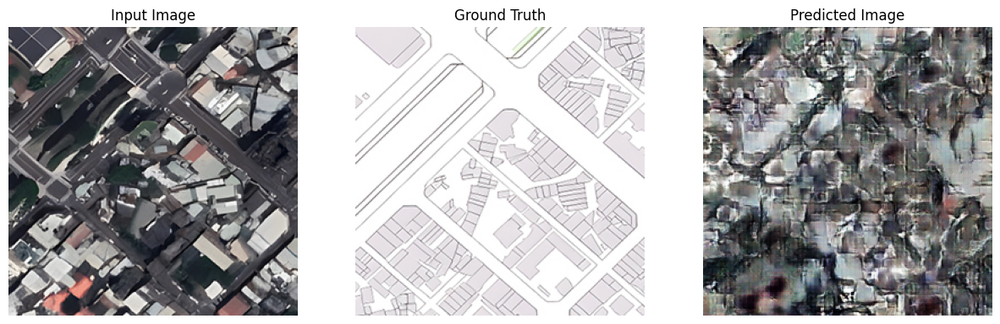

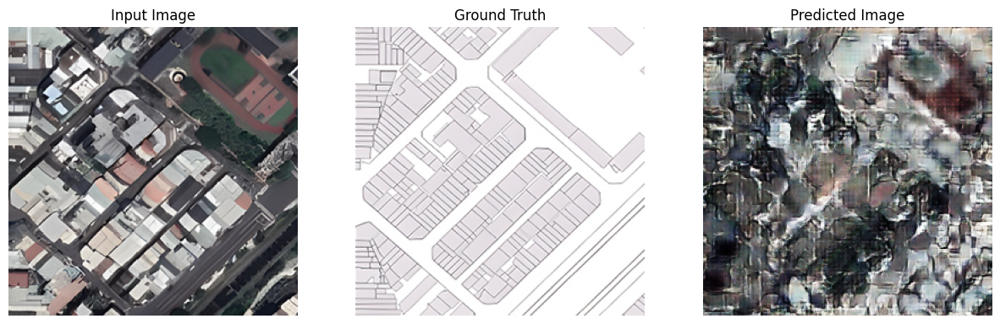

In [ ]:
import zipfile
import io
from PIL import Image

def display_images_from_zip(zip_url, generator):
    # Download the zip file
    response = requests.get(zip_url)
    zip_data = io.BytesIO(response.content)

    # Open the zip file
    with zipfile.ZipFile(zip_data) as zf:
        for file in zf.namelist():
            if file.lower().endswith(('.png', '.jpg', '.jpeg')):
                # Read the image from the zip file
                with zf.open(file) as image_file:
                    target_image = Image.open(image_file)
                    target_image = target_image.resize((512, 256))
                    target_image = np.array(target_image) / 255.0
                    target_image = target_image * 2 - 1
                    target_image = np.expand_dims(target_image, axis=0)
                    target_image = tf.convert_to_tensor(target_image, dtype=tf.float32)


                    ground_truth = target_image[:, :, :256]
                    input_image = target_image[:, :, 256:]

                    # Generate the output using the generator model
                    generated_image = generator(input_image, training=True)

                    # Display the input, generated, and target images
                    display_input_generated_target(input_image, generated_image, ground_truth)

# Assuming you have a trained generator (pix2pix model) called 'generator'
# Replace 'your_zip_url' with the actual URL of the zip file
your_zip_url = 'https://drive.google.com/uc?export=download&id=1arCMcnxJBGV1RgtPHRfNzW9MuxozEj7d'
display_images_from_zip(your_zip_url, generator)
